<h1>Table of Contents<span class="tocSkip"></span></h1>
<div class="toc"><ul class="toc-item"><li><span><a href="#Prerequisites" data-toc-modified-id="Prerequisites-1"><span class="toc-item-num">1&nbsp;&nbsp;</span>Prerequisites</a></span><ul class="toc-item"><li><span><a href="#Importing-Libraries-and-settings" data-toc-modified-id="Importing-Libraries-and-settings-1.1"><span class="toc-item-num">1.1&nbsp;&nbsp;</span>Importing Libraries and settings</a></span></li></ul></li><li><span><a href="#EDA,-Data-cleaning-&amp;-Analysis-of-missing-values-continued..." data-toc-modified-id="EDA,-Data-cleaning-&amp;-Analysis-of-missing-values-continued...-2"><span class="toc-item-num">2&nbsp;&nbsp;</span>EDA, Data cleaning &amp; Analysis of missing values continued...</a></span><ul class="toc-item"><li><span><a href="#Reading-the-dataset--&amp;-basic-data-cleaning" data-toc-modified-id="Reading-the-dataset--&amp;-basic-data-cleaning-2.1"><span class="toc-item-num">2.1&nbsp;&nbsp;</span>Reading the dataset  &amp; basic data cleaning</a></span></li><li><span><a href="#Missing-value-imputation-strategy" data-toc-modified-id="Missing-value-imputation-strategy-2.2"><span class="toc-item-num">2.2&nbsp;&nbsp;</span>Missing value imputation strategy</a></span><ul class="toc-item"><li><span><a href="#Filling-PM2.5-using-ffill()" data-toc-modified-id="Filling-PM2.5-using-ffill()-2.2.1"><span class="toc-item-num">2.2.1&nbsp;&nbsp;</span>Filling PM2.5 using ffill()</a></span></li><li><span><a href="#Filling-missing-values---NO,-NO2,-NOx,-CO" data-toc-modified-id="Filling-missing-values---NO,-NO2,-NOx,-CO-2.2.2"><span class="toc-item-num">2.2.2&nbsp;&nbsp;</span>Filling missing values - NO, NO2, NOx, CO</a></span></li><li><span><a href="#Filling-missing-values-in-SO2" data-toc-modified-id="Filling-missing-values-in-SO2-2.2.3"><span class="toc-item-num">2.2.3&nbsp;&nbsp;</span>Filling missing values in SO2</a></span><ul class="toc-item"><li><span><a href="#Filling-non-NISE-SO2-missing-values" data-toc-modified-id="Filling-non-NISE-SO2-missing-values-2.2.3.1"><span class="toc-item-num">2.2.3.1&nbsp;&nbsp;</span>Filling non-NISE SO2 missing values</a></span></li><li><span><a href="#Filling-NISE-SO2-missing-values" data-toc-modified-id="Filling-NISE-SO2-missing-values-2.2.3.2"><span class="toc-item-num">2.2.3.2&nbsp;&nbsp;</span>Filling NISE SO2 missing values</a></span></li></ul></li><li><span><a href="#Save-the-dataframe" data-toc-modified-id="Save-the-dataframe-2.2.4"><span class="toc-item-num">2.2.4&nbsp;&nbsp;</span>Save the dataframe</a></span></li></ul></li></ul></li><li><span><a href="#End-of-part-3---To-be-continued..." data-toc-modified-id="End-of-part-3---To-be-continued...-3"><span class="toc-item-num">3&nbsp;&nbsp;</span>End of part 3 - To be continued...</a></span></li></ul></div>

# Prerequisites

## Importing Libraries and settings

In [2]:
# For data cleaning and EDA
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt 
import seaborn as sns
import random as rnd
import plotly.express as px 
import datetime

# To print multiple outputs in a single cell
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"

# Plot settings
sns.set(rc={"figure.dpi":100, 'savefig.dpi':300})
sns.set_context('notebook')
sns.set_style("ticks")
from IPython.display import set_matplotlib_formats
# set_matplotlib_formats('retina')
%config InlineBackend.figure_format = 'retina'
plt.style.use('tableau-colorblind10')

# Set default font sizes
import matplotlib as mpl
mpl.rcParams['axes.titlesize'] = 20 # Title
mpl.rcParams['axes.titleweight'] = 'bold' # Make title bold 
mpl.rcParams['axes.labelsize'] = 16 # X-Axis & Y-Axis
mpl.rcParams['axes.labelweight'] = 'bold' # Make labels bold
mpl.rcParams['xtick.labelsize'] = 14 # X-ticks
mpl.rcParams['ytick.labelsize'] = 14 # Y-ticks

# Use Plotly color palette
plotly_color_scale = px.colors.qualitative.Plotly
custom_colors = plotly_color_scale

# EDA, Data cleaning & Analysis of missing values continued...

## Reading the dataset  & basic data cleaning

In [3]:
compiled = pd.read_csv('../../data/preprocessing_data/compiled_part_2_end.csv')
compiled

/var/folders/27/b03t8q596qvcmtyqjtnh0w6w0000gn/T/ipykernel_8799/542830360.py:1: DtypeWarning: Columns (14) have mixed types. Specify dtype option on import or set low_memory=False.
  compiled = pd.read_csv('../../data/preprocessing_data/compiled_part_2_end.csv')


,Unnamed: 0,Datetime,Station,PM2.5,NO,NO2,NOx,SO2,CO,Ozone,Benzene,TOT-RF,PM10,AQI,AQI_Bucket,Day,Month,Year,Week,Hour
0,0,2020-03-04 00:00:00,Vikas Sadan,60.92,141.22,61.53,144.62,10.50,3.01,5.08,2.04,0.0,NaN,NaN,NaN,4,3,2020,10,0
1,1,2020-03-04 01:00:00,Vikas Sadan,56.88,177.38,56.39,170.94,5.64,5.38,6.15,2.00,0.0,NaN,NaN,NaN,4,3,2020,10,1
2,2,2020-03-04 02:00:00,Vikas Sadan,63.33,302.33,40.26,262.69,7.60,1.85,12.72,2.02,0.0,NaN,NaN,NaN,4,3,2020,10,2
3,3,2020-03-04 03:00:00,Vikas Sadan,67.60,377.93,29.18,317.53,10.53,1.31,11.46,1.96,0.0,NaN,NaN,NaN,4,3,2020,10,3
4,4,2020-03-04 04:00:00,Vikas Sadan,72.72,319.80,33.66,273.25,9.98,0.63,4.76,2.01,0.0,NaN,NaN,NaN,4,3,2020,10,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
147526,147526,2020-06-30 20:00:00,No Station,54.74,6.23,10.67,12.60,4.18,0.60,NaN,2.14,NaN,135.42,154.0,Moderate,30,6,2020,27,20
147527,147527,2020-06-30 21:00:00,No Station,54.37,6.30,10.28,11.88,4.03,1.20,NaN,1.87,NaN,136.11,154.0,Moderate,30,6,2020,27,21
147528,147528,2020-06-30 22:00:00,No Station,50.34,6.93,10.36,13.01,6.17,1.00,NaN,2.41,NaN,147.32,155.0,Moderate,30,6,2020,27,22
147529,147529,2020-06-30 23:00:00,No Station,53.23,6.64,10.30,12.75,6.31,0.86,NaN,2.54,NaN,163.15,156.0,Moderate,30,6,2020,27,23


In [4]:
compiled.drop(['Unnamed: 0'], axis=1, inplace=True)

In [5]:
compiled['Datetime'] = pd.to_datetime(compiled['Datetime'])

In [6]:
compiled

,Datetime,Station,PM2.5,NO,NO2,NOx,SO2,CO,Ozone,Benzene,TOT-RF,PM10,AQI,AQI_Bucket,Day,Month,Year,Week,Hour
0,2020-03-04 00:00:00,Vikas Sadan,60.92,141.22,61.53,144.62,10.50,3.01,5.08,2.04,0.0,NaN,NaN,NaN,4,3,2020,10,0
1,2020-03-04 01:00:00,Vikas Sadan,56.88,177.38,56.39,170.94,5.64,5.38,6.15,2.00,0.0,NaN,NaN,NaN,4,3,2020,10,1
2,2020-03-04 02:00:00,Vikas Sadan,63.33,302.33,40.26,262.69,7.60,1.85,12.72,2.02,0.0,NaN,NaN,NaN,4,3,2020,10,2
3,2020-03-04 03:00:00,Vikas Sadan,67.60,377.93,29.18,317.53,10.53,1.31,11.46,1.96,0.0,NaN,NaN,NaN,4,3,2020,10,3
4,2020-03-04 04:00:00,Vikas Sadan,72.72,319.80,33.66,273.25,9.98,0.63,4.76,2.01,0.0,NaN,NaN,NaN,4,3,2020,10,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
147526,2020-06-30 20:00:00,No Station,54.74,6.23,10.67,12.60,4.18,0.60,NaN,2.14,NaN,135.42,154.0,Moderate,30,6,2020,27,20
147527,2020-06-30 21:00:00,No Station,54.37,6.30,10.28,11.88,4.03,1.20,NaN,1.87,NaN,136.11,154.0,Moderate,30,6,2020,27,21
147528,2020-06-30 22:00:00,No Station,50.34,6.93,10.36,13.01,6.17,1.00,NaN,2.41,NaN,147.32,155.0,Moderate,30,6,2020,27,22
147529,2020-06-30 23:00:00,No Station,53.23,6.64,10.30,12.75,6.31,0.86,NaN,2.54,NaN,163.15,156.0,Moderate,30,6,2020,27,23


## Missing value imputation strategy

In [8]:
import PIL.Image as Image

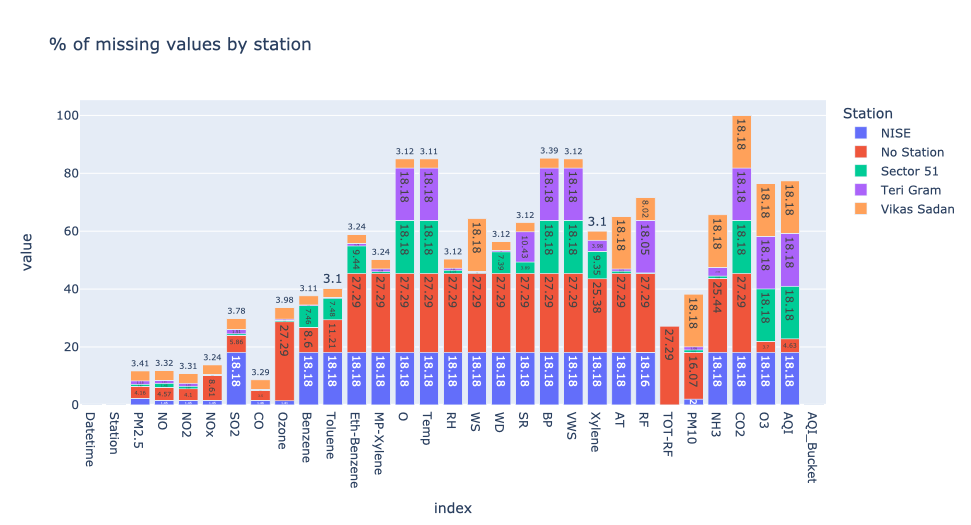

In [14]:
Image.open("../../images/% of missing values by station.png")

- Based on this plot -> **% of missing values by station.png** 
- Important features ['PM2.5', 'NO', 'NO2', 'NOx', 'SO2', 'CO', 'PM10']
- We can remove other columns as missing values percentage is more than 40%.
- We can impute missing values using 2 methods,
    - backward fill **bill()** 
    - forward fill **ffill()**
- **PM2.5**
    - Station-wise do bfill or ffill
- **NO**
    - Station-wise do bfill or ffill
- **NO2**
    - Station-wise do bfill or ffill
- **NOx**
    - Station-wise do bfill or ffill
- **SO2**
    - Except NISE, do station-wise bfill or ffill
    - Now, for NISE, take average of other stations on that day and impute. (Don't impute mean of all values in the column, for each day, wherever there is missing SO2, go to other stations on that day and take average.)
    - To do this, first check with other columns if NISE is avg of other stations. (Checked it, it works)
    - If average of other 3 stations does not work, then take all non-NaNs in SO2, check with collinearity with other stations, whichever has high correlation, take that station.
- **CO**
    - Station-wise do bfill or ffill
- **PM10**
    - Except ***"No Station"*** & ***"Vikas Sadan"***, do station-wise bfill or ffill
    - Follow similar approach like SO2.

In [7]:
# Create a copy of the dataset

compiled_ffill = compiled.copy()
compiled_ffill.sort_values(['Station','Datetime'], inplace=True)
compiled_ffill.columns

compiled_ffill.isna().sum()
compiled_ffill.shape

Index(['Datetime', 'Station', 'PM2.5', 'NO', 'NO2', 'NOx', 'SO2', 'CO',
       'Ozone', 'Benzene', 'TOT-RF', 'PM10', 'AQI', 'AQI_Bucket', 'Day',
       'Month', 'Year', 'Week', 'Hour'],
      dtype='object')

Datetime           0
Station            0
PM2.5          17257
NO             17443
NO2            15918
NOx            20315
SO2            43996
CO             12704
Ozone          49599
Benzene        55514
TOT-RF         40258
PM10           56362
AQI           114111
AQI_Bucket    114111
Day                0
Month              0
Year               0
Week               0
Hour               0
dtype: int64

(147531, 19)

### Filling PM2.5 using ffill()

<Figure size 2000x800 with 0 Axes>

<AxesSubplot: ylabel='PM2.5'>

Text(0.5, 1.0, 'PM2.5 data from 2015 to 2023 - Imputed missing values with -100')

Text(0.5, 0, 'Datetime')

Text(0, 0.5, 'PM2.5')

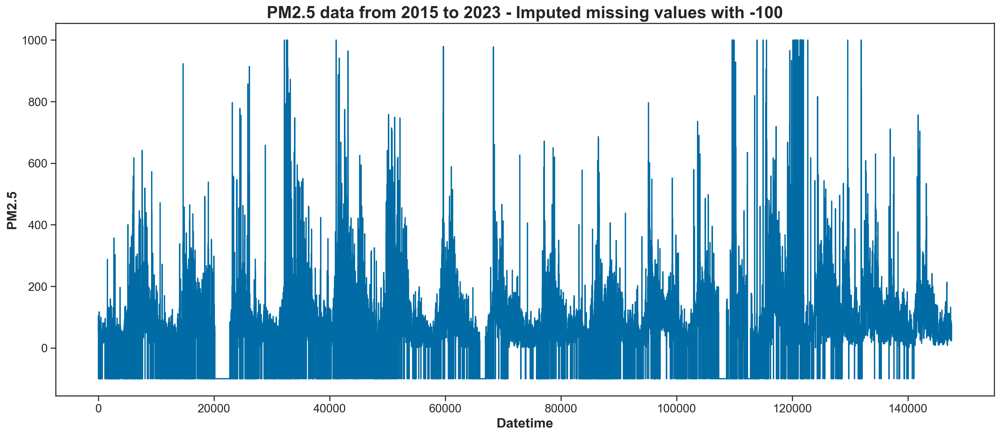

In [17]:
plt.figure(figsize=(20,8))
sns.lineplot(compiled_ffill['PM2.5'].fillna(-100))
plt.title("PM2.5 data from 2015 to 2023 - Imputed missing values with -100")
plt.xlabel("Datetime")
plt.ylabel("PM2.5")

In [19]:
px.line(data_frame=compiled_ffill, x="Datetime", y="PM2.5", title='PM2.5 data from 2015 to 2023 with missing values')

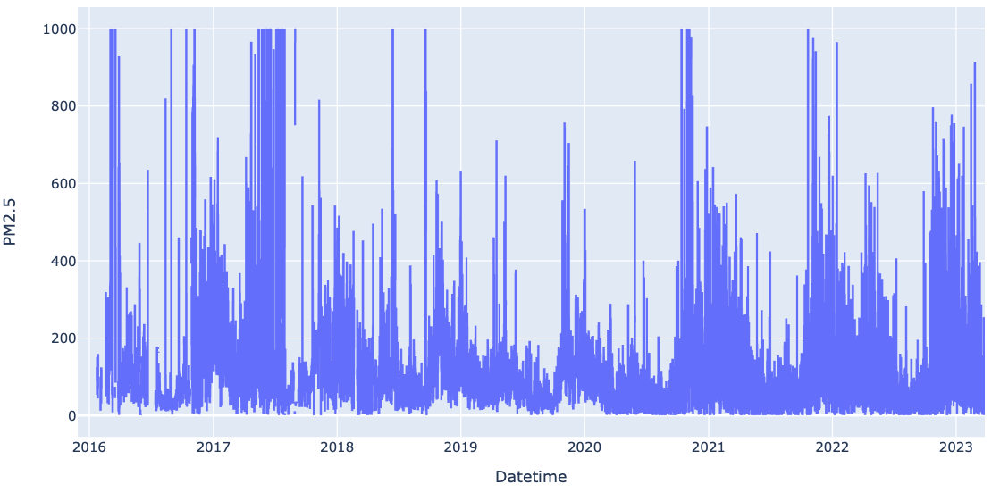

In [20]:
compiled_ffill["PM2.5"].ffill(inplace=True)

In [23]:
# Plotting now, after filling missing values

px.line(data_frame=compiled_ffill, x="Datetime", y="PM2.5", title="PM2.5 data from 2015 to 2023 with missing values filled")

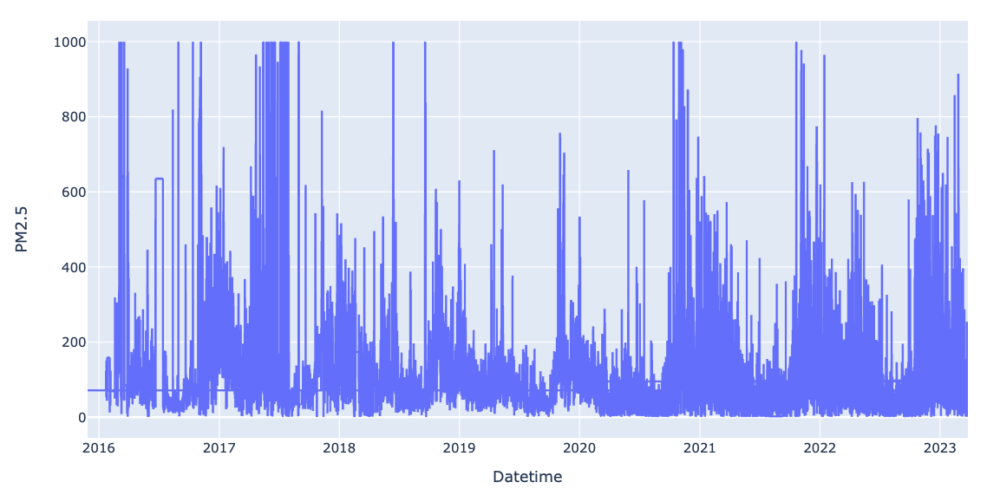

In [28]:
# Find a row where all columns are not missing

compiled[~compiled.isnull().any(axis=1)]

,Datetime,Station,PM2.5,NO,NO2,NOx,SO2,CO,Ozone,Benzene,TOT-RF,PM10,AQI,AQI_Bucket,Day,Month,Year,Week,Hour


- We do not see any such row.

### Filling missing values - NO, NO2, NOx, CO

In [ ]:
compiled_ffill["NO"].ffill(inplace=True)
compiled_ffill["NO2"].ffill(inplace=True)
compiled_ffill["NOx"].ffill(inplace=True)
compiled_ffill["CO"].ffill(inplace=True)

### Filling missing values in SO2

In [29]:
compiled_ffill[compiled_ffill['Station'] != 'NISE']

,Datetime,Station,PM2.5,NO,NO2,NOx,SO2,CO,Ozone,Benzene,TOT-RF,PM10,AQI,AQI_Bucket,Day,Month,Year,Week,Hour
107273,2015-11-27 15:00:00,No Station,71.08,8.88,12.50,5.85,NaN,0.08,NaN,NaN,NaN,NaN,NaN,NaN,27,11,2015,48,15
107274,2015-11-27 16:00:00,No Station,71.08,4.02,10.03,10.34,8.38,1.40,NaN,NaN,NaN,NaN,NaN,NaN,27,11,2015,48,16
107275,2015-11-27 17:00:00,No Station,71.08,11.25,7.07,15.14,16.69,1.75,NaN,NaN,NaN,NaN,NaN,NaN,27,11,2015,48,17
107276,2015-11-27 18:00:00,No Station,71.08,4.55,7.06,8.44,18.85,2.91,NaN,NaN,NaN,NaN,NaN,NaN,27,11,2015,48,18
107277,2015-11-27 19:00:00,No Station,71.08,5.68,7.80,9.67,21.52,4.58,NaN,NaN,NaN,NaN,NaN,NaN,27,11,2015,48,19
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
26811,2023-03-26 03:00:00,Vikas Sadan,83.22,23.90,49.59,70.03,41.30,0.87,26.16,4.57,0.0,NaN,NaN,NaN,26,3,2023,12,3
26812,2023-03-26 04:00:00,Vikas Sadan,71.96,24.25,53.15,71.91,40.56,0.66,17.46,8.22,0.0,NaN,NaN,NaN,26,3,2023,12,4
26813,2023-03-26 05:00:00,Vikas Sadan,75.47,24.55,54.38,64.34,40.82,0.28,37.73,8.21,0.0,NaN,NaN,NaN,26,3,2023,12,5
26814,2023-03-26 06:00:00,Vikas Sadan,69.07,23.09,54.48,72.73,39.29,0.43,22.46,8.15,0.0,NaN,NaN,NaN,26,3,2023,12,6


In [30]:
# SO2 column - Both 1st row and last row are NaNs so bfill and ffill has issue.
# So, manually fill them, then we can use bfill() or ffill()

compiled_ffill.loc[26815,"SO2"] = compiled_ffill.loc[26814,"SO2"]
compiled_ffill.loc[26815,"SO2"] 

39.29

In [31]:
compiled_ffill.loc[107273,"SO2"] = compiled_ffill.loc[107274,"SO2"]

In [32]:
compiled_ffill.loc[compiled_ffill['Station'] != 'NISE',"SO2"]

107273     8.38
107274     8.38
107275    16.69
107276    18.85
107277    21.52
          ...  
26811     41.30
26812     40.56
26813     40.82
26814     39.29
26815     39.29
Name: SO2, Length: 120715, dtype: float64

In [33]:
compiled_ffill[compiled_ffill['SO2'].isnull()]

,Datetime,Station,PM2.5,NO,NO2,NOx,SO2,CO,Ozone,Benzene,TOT-RF,PM10,AQI,AQI_Bucket,Day,Month,Year,Week,Hour
53641,2020-03-04 00:00:00,NISE,88.67,17.92,31.11,49.03,NaN,2.55,5.99,NaN,0.0,184.54,NaN,NaN,4,3,2020,10,0
53642,2020-03-04 01:00:00,NISE,82.42,16.90,29.54,46.43,NaN,2.42,6.72,NaN,0.0,178.92,NaN,NaN,4,3,2020,10,1
53643,2020-03-04 02:00:00,NISE,82.35,17.71,29.56,47.33,NaN,2.40,6.11,NaN,0.0,187.56,NaN,NaN,4,3,2020,10,2
53644,2020-03-04 03:00:00,NISE,102.34,18.05,27.90,45.92,NaN,2.36,4.63,NaN,0.0,211.59,NaN,NaN,4,3,2020,10,3
53645,2020-03-04 04:00:00,NISE,97.36,15.49,23.88,39.35,NaN,2.24,4.60,NaN,0.0,181.50,NaN,NaN,4,3,2020,10,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
26774,2023-03-24 14:00:00,Vikas Sadan,88.63,17.18,30.47,47.73,NaN,0.10,NaN,NaN,0.0,NaN,NaN,NaN,24,3,2023,12,14
26775,2023-03-24 15:00:00,Vikas Sadan,88.63,17.18,30.47,47.73,NaN,0.10,NaN,NaN,0.0,NaN,NaN,NaN,24,3,2023,12,15
26776,2023-03-24 16:00:00,Vikas Sadan,88.63,17.18,30.47,47.73,NaN,0.10,NaN,NaN,0.0,NaN,NaN,NaN,24,3,2023,12,16
26777,2023-03-24 17:00:00,Vikas Sadan,88.63,17.18,30.47,47.73,NaN,0.10,NaN,NaN,0.0,NaN,NaN,NaN,24,3,2023,12,17


In [34]:
compiled_ffill.loc[compiled_ffill['Station'] != 'NISE',:]
# .bfill(inplace=True)

,Datetime,Station,PM2.5,NO,NO2,NOx,SO2,CO,Ozone,Benzene,TOT-RF,PM10,AQI,AQI_Bucket,Day,Month,Year,Week,Hour
107273,2015-11-27 15:00:00,No Station,71.08,8.88,12.50,5.85,8.38,0.08,NaN,NaN,NaN,NaN,NaN,NaN,27,11,2015,48,15
107274,2015-11-27 16:00:00,No Station,71.08,4.02,10.03,10.34,8.38,1.40,NaN,NaN,NaN,NaN,NaN,NaN,27,11,2015,48,16
107275,2015-11-27 17:00:00,No Station,71.08,11.25,7.07,15.14,16.69,1.75,NaN,NaN,NaN,NaN,NaN,NaN,27,11,2015,48,17
107276,2015-11-27 18:00:00,No Station,71.08,4.55,7.06,8.44,18.85,2.91,NaN,NaN,NaN,NaN,NaN,NaN,27,11,2015,48,18
107277,2015-11-27 19:00:00,No Station,71.08,5.68,7.80,9.67,21.52,4.58,NaN,NaN,NaN,NaN,NaN,NaN,27,11,2015,48,19
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
26811,2023-03-26 03:00:00,Vikas Sadan,83.22,23.90,49.59,70.03,41.30,0.87,26.16,4.57,0.0,NaN,NaN,NaN,26,3,2023,12,3
26812,2023-03-26 04:00:00,Vikas Sadan,71.96,24.25,53.15,71.91,40.56,0.66,17.46,8.22,0.0,NaN,NaN,NaN,26,3,2023,12,4
26813,2023-03-26 05:00:00,Vikas Sadan,75.47,24.55,54.38,64.34,40.82,0.28,37.73,8.21,0.0,NaN,NaN,NaN,26,3,2023,12,5
26814,2023-03-26 06:00:00,Vikas Sadan,69.07,23.09,54.48,72.73,39.29,0.43,22.46,8.15,0.0,NaN,NaN,NaN,26,3,2023,12,6


In [35]:
# compiled_ffill.loc[compiled_ffill['Station'] != 'NISE',"SO2"] = compiled_ffill.loc[compiled_ffill['Station'] != 'NISE',"SO2"].bfill(inplace=True)
compiled_ffill.loc[compiled_ffill['Station'] != 'NISE',"SO2"]
compiled_ffill.loc[compiled_ffill['Station'] != 'NISE',"SO2"].bfill()

107273     8.38
107274     8.38
107275    16.69
107276    18.85
107277    21.52
          ...  
26811     41.30
26812     40.56
26813     40.82
26814     39.29
26815     39.29
Name: SO2, Length: 120715, dtype: float64

107273     8.38
107274     8.38
107275    16.69
107276    18.85
107277    21.52
          ...  
26811     41.30
26812     40.56
26813     40.82
26814     39.29
26815     39.29
Name: SO2, Length: 120715, dtype: float64

In [36]:
# Taking a copy

temp_so2 = compiled_ffill.copy()
temp_so2

,Datetime,Station,PM2.5,NO,NO2,NOx,SO2,CO,Ozone,Benzene,TOT-RF,PM10,AQI,AQI_Bucket,Day,Month,Year,Week,Hour
53641,2020-03-04 00:00:00,NISE,88.67,17.92,31.11,49.03,NaN,2.55,5.99,NaN,0.0,184.54,NaN,NaN,4,3,2020,10,0
53642,2020-03-04 01:00:00,NISE,82.42,16.90,29.54,46.43,NaN,2.42,6.72,NaN,0.0,178.92,NaN,NaN,4,3,2020,10,1
53643,2020-03-04 02:00:00,NISE,82.35,17.71,29.56,47.33,NaN,2.40,6.11,NaN,0.0,187.56,NaN,NaN,4,3,2020,10,2
53644,2020-03-04 03:00:00,NISE,102.34,18.05,27.90,45.92,NaN,2.36,4.63,NaN,0.0,211.59,NaN,NaN,4,3,2020,10,3
53645,2020-03-04 04:00:00,NISE,97.36,15.49,23.88,39.35,NaN,2.24,4.60,NaN,0.0,181.50,NaN,NaN,4,3,2020,10,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
26811,2023-03-26 03:00:00,Vikas Sadan,83.22,23.90,49.59,70.03,41.30,0.87,26.16,4.57,0.0,NaN,NaN,NaN,26,3,2023,12,3
26812,2023-03-26 04:00:00,Vikas Sadan,71.96,24.25,53.15,71.91,40.56,0.66,17.46,8.22,0.0,NaN,NaN,NaN,26,3,2023,12,4
26813,2023-03-26 05:00:00,Vikas Sadan,75.47,24.55,54.38,64.34,40.82,0.28,37.73,8.21,0.0,NaN,NaN,NaN,26,3,2023,12,5
26814,2023-03-26 06:00:00,Vikas Sadan,69.07,23.09,54.48,72.73,39.29,0.43,22.46,8.15,0.0,NaN,NaN,NaN,26,3,2023,12,6


In [37]:
temp_so2.loc[temp_so2['Station'] != 'NISE',"SO2"].bfill()
temp_so2.loc[temp_so2['Station'] != 'NISE',"SO2"].isna().sum()

107273     8.38
107274     8.38
107275    16.69
107276    18.85
107277    21.52
          ...  
26811     41.30
26812     40.56
26813     40.82
26814     39.29
26815     39.29
Name: SO2, Length: 120715, dtype: float64

17178

In [38]:
# Fill Non-NISE SO2 missing values

temp_so2.loc[temp_so2['Station'] != 'NISE',"SO2"] = temp_so2.loc[temp_so2['Station'] != 'NISE',"SO2"].bfill()

temp_so2.loc[temp_so2['Station'] != 'NISE',"SO2"].isna().sum()

0

- Now, the NaN count is 0
- Now, fill it in the actual DataFrame **compiled_ffill**

#### Filling non-NISE SO2 missing values

In [39]:
compiled_ffill.loc[compiled_ffill['Station'] != 'NISE',"SO2"] = temp_so2.loc[temp_so2['Station'] != 'NISE',"SO2"]
compiled_ffill.loc[compiled_ffill['Station'] != 'NISE',"SO2"]

107273     8.38
107274     8.38
107275    16.69
107276    18.85
107277    21.52
          ...  
26811     41.30
26812     40.56
26813     40.82
26814     39.29
26815     39.29
Name: SO2, Length: 120715, dtype: float64

In [40]:
compiled_ffill[compiled_ffill['Station'] != 'NISE']['SO2'].isna().sum()

0

- Non-NISE SO2 NaN count is 0
- Checking the count of NISE SO2 now

#### Filling NISE SO2 missing values
- Now, for NISE, take average of other stations on that day and impute. (Dont impute mean of all values in the column, for each day, wherever there is missing SO2, go to other stations on that day and take average.)
- To do this, first check with other columns if NISE is avg of other stations. (Checked it, it works.)
- If average of other 3 stations does not work, then take all non-NaNs in SO2, check with collinearity with other stations, whichever has high correlation, take that station.

In [41]:
compiled_ffill[compiled_ffill['Station'] == 'NISE']['SO2'].isna().sum()

26816

- There are 26816 NaNs in NISE SO2

In [42]:
compiled_ffill.isna().sum()

Datetime           0
Station            0
PM2.5              0
NO                 0
NO2                0
NOx                0
SO2            26816
CO                 0
Ozone          49599
Benzene        55514
TOT-RF         40258
PM10           56362
AQI           114111
AQI_Bucket    114111
Day                0
Month              0
Year               0
Week               0
Hour               0
dtype: int64

In [43]:
# Just checking if we can take average of other stations 

compiled_ffill[~compiled_ffill['SO2'].isna()].sort_values(['Datetime','Station'])

,Datetime,Station,PM2.5,NO,NO2,NOx,SO2,CO,Ozone,Benzene,TOT-RF,PM10,AQI,AQI_Bucket,Day,Month,Year,Week,Hour
107273,2015-11-27 15:00:00,No Station,71.08,8.88,12.50,5.85,8.38,0.08,NaN,NaN,NaN,NaN,NaN,NaN,27,11,2015,48,15
107274,2015-11-27 16:00:00,No Station,71.08,4.02,10.03,10.34,8.38,1.40,NaN,NaN,NaN,NaN,NaN,NaN,27,11,2015,48,16
107275,2015-11-27 17:00:00,No Station,71.08,11.25,7.07,15.14,16.69,1.75,NaN,NaN,NaN,NaN,NaN,NaN,27,11,2015,48,17
107276,2015-11-27 18:00:00,No Station,71.08,4.55,7.06,8.44,18.85,2.91,NaN,NaN,NaN,NaN,NaN,NaN,27,11,2015,48,18
107277,2015-11-27 19:00:00,No Station,71.08,5.68,7.80,9.67,21.52,4.58,NaN,NaN,NaN,NaN,NaN,NaN,27,11,2015,48,19
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
53636,2023-03-26 12:00:00,Sector 51,79.90,12.23,30.99,24.74,1.50,0.59,60.85,9.88,0.0,147.95,NaN,NaN,26,3,2023,12,12
53637,2023-03-26 13:00:00,Sector 51,86.35,7.93,31.41,21.17,1.44,0.53,55.47,9.00,0.0,159.93,NaN,NaN,26,3,2023,12,13
53638,2023-03-26 14:00:00,Sector 51,85.30,5.51,31.52,12.85,1.16,0.32,52.25,8.27,0.0,158.00,NaN,NaN,26,3,2023,12,14
53639,2023-03-26 15:00:00,Sector 51,86.78,2.86,27.01,14.85,35.13,0.40,54.39,3.17,0.0,160.78,NaN,NaN,26,3,2023,12,15


In [46]:
compiled_ffill.sort_values(['Datetime','Station']).sample(10)

,Datetime,Station,PM2.5,NO,NO2,NOx,SO2,CO,Ozone,Benzene,TOT-RF,PM10,AQI,AQI_Bucket,Day,Month,Year,Week,Hour
804,2020-04-06 12:00:00,Vikas Sadan,46.38,4.93,9.66,9.01,7.91,0.43,89.98,1.95,0.0,NaN,NaN,NaN,6,4,2020,15,12
77001,2022-11-02 08:00:00,NISE,142.01,8.66,33.63,42.30,NaN,0.72,17.81,NaN,0.0,42.67,NaN,NaN,2,11,2022,44,8
22726,2022-10-06 22:00:00,Vikas Sadan,46.20,9.71,11.54,16.65,6.35,0.41,NaN,NaN,0.0,NaN,NaN,NaN,6,10,2022,40,22
98213,2022-03-13 20:00:00,Teri Gram,95.30,13.84,17.27,38.92,1.19,0.65,7.54,3.29,0.0,175.22,NaN,NaN,13,3,2022,10,20
118539,2017-03-11 01:00:00,No Station,8.89,7.95,17.71,17.90,4.76,0.46,NaN,NaN,NaN,NaN,53.0,Satisfactory,11,3,2017,10,1
38581,2021-07-07 05:00:00,Sector 51,64.82,11.25,3.79,9.59,2.88,0.42,12.25,7.42,0.0,66.10,NaN,NaN,7,7,2021,27,5
117567,2017-01-29 13:00:00,No Station,143.21,6.98,9.88,17.90,5.91,0.66,NaN,4.37,NaN,NaN,262.0,Poor,29,1,2017,4,13
93299,2021-08-21 02:00:00,Teri Gram,28.95,9.10,13.03,26.94,1.85,0.63,30.15,5.82,0.0,42.67,NaN,NaN,21,8,2021,33,2
39476,2021-08-13 12:00:00,Sector 51,34.77,2.98,8.46,7.21,3.48,1.21,20.59,4.98,0.0,71.50,NaN,NaN,13,8,2021,32,12
99405,2022-05-02 12:00:00,Teri Gram,89.12,6.91,9.46,15.36,2.05,0.51,25.93,3.48,0.0,255.50,NaN,NaN,2,5,2022,18,12


In [47]:
# 61670 So2 is NaN
# 2021-02-01 13:00:00

compiled_ffill.loc[61650:61690,:].sort_values(['Datetime','Station'])

,Datetime,Station,PM2.5,NO,NO2,NOx,SO2,CO,Ozone,Benzene,TOT-RF,PM10,AQI,AQI_Bucket,Day,Month,Year,Week,Hour
61650,2021-01-31 17:00:00,NISE,49.69,2.68,8.04,10.72,NaN,0.07,73.21,NaN,0.0,101.25,NaN,NaN,31,1,2021,4,17
61651,2021-01-31 18:00:00,NISE,50.08,2.80,8.45,11.25,NaN,0.05,53.39,NaN,0.0,99.86,NaN,NaN,31,1,2021,4,18
61652,2021-01-31 19:00:00,NISE,62.59,3.08,8.94,12.02,NaN,0.08,36.19,NaN,0.0,107.59,NaN,NaN,31,1,2021,4,19
61653,2021-01-31 20:00:00,NISE,122.95,3.35,10.76,14.13,NaN,0.18,31.06,NaN,0.0,181.20,NaN,NaN,31,1,2021,4,20
61654,2021-01-31 21:00:00,NISE,156.50,3.79,11.63,15.42,NaN,0.25,33.21,NaN,0.0,229.91,NaN,NaN,31,1,2021,4,21
61655,2021-01-31 22:00:00,NISE,184.62,4.94,12.63,17.58,NaN,0.43,31.35,NaN,0.0,259.84,NaN,NaN,31,1,2021,4,22
61656,2021-01-31 23:00:00,NISE,178.71,4.76,11.63,16.38,NaN,0.42,29.32,NaN,0.0,237.10,NaN,NaN,31,1,2021,4,23
61657,2021-02-01 00:00:00,NISE,166.86,4.31,10.47,14.78,NaN,0.41,28.34,NaN,0.0,228.91,NaN,NaN,1,2,2021,5,0
61658,2021-02-01 01:00:00,NISE,150.06,3.79,9.90,13.69,NaN,0.32,28.46,NaN,0.0,228.43,NaN,NaN,1,2,2021,5,1
61659,2021-02-01 02:00:00,NISE,151.25,5.27,10.27,15.55,NaN,0.35,27.38,NaN,0.0,198.58,NaN,NaN,1,2,2021,5,2


In [48]:
# 74249 ; 2022-07-10 16:00:00	NISE
compiled_ffill.loc[28229:28259, :].sort_values(['Datetime'])
compiled.loc[28229:28259, :].sort_values(['Datetime'])

,Datetime,Station,PM2.5,NO,NO2,NOx,SO2,CO,Ozone,Benzene,TOT-RF,PM10,AQI,AQI_Bucket,Day,Month,Year,Week,Hour
28229,2020-05-01 21:00:00,Sector 51,54.11,1.48,10.54,6.69,10.22,0.65,119.80,3.39,0.0,188.00,NaN,NaN,1,5,2020,18,21
28230,2020-05-01 22:00:00,Sector 51,48.78,3.00,9.88,7.57,10.16,0.62,105.06,3.35,0.0,174.44,NaN,NaN,1,5,2020,18,22
28231,2020-05-01 23:00:00,Sector 51,46.59,3.21,9.81,7.70,10.28,0.60,101.00,3.20,0.0,162.60,NaN,NaN,1,5,2020,18,23
28232,2020-05-02 00:00:00,Sector 51,45.80,0.35,9.77,4.90,7.66,0.60,91.91,3.18,0.0,147.85,NaN,NaN,2,5,2020,18,0
28233,2020-05-02 01:00:00,Sector 51,43.82,0.35,9.71,4.16,8.41,0.57,85.55,3.26,0.0,137.37,NaN,NaN,2,5,2020,18,1
28234,2020-05-02 02:00:00,Sector 51,41.15,0.45,9.82,4.93,9.01,0.56,81.20,3.11,0.0,131.77,NaN,NaN,2,5,2020,18,2
28235,2020-05-02 03:00:00,Sector 51,35.31,1.39,9.56,6.11,8.89,0.54,80.05,3.13,0.0,117.50,NaN,NaN,2,5,2020,18,3
28236,2020-05-02 04:00:00,Sector 51,29.38,1.62,9.78,6.42,7.06,0.48,75.62,3.08,0.0,112.26,NaN,NaN,2,5,2020,18,4
28237,2020-05-02 05:00:00,Sector 51,30.04,0.77,10.38,5.77,7.50,0.47,68.57,3.13,0.0,111.79,NaN,NaN,2,5,2020,18,5
28238,2020-05-02 06:00:00,Sector 51,32.38,0.77,10.71,4.97,7.02,0.47,65.94,3.15,0.0,112.77,NaN,NaN,2,5,2020,18,6


,Datetime,Station,PM2.5,NO,NO2,NOx,SO2,CO,Ozone,Benzene,TOT-RF,PM10,AQI,AQI_Bucket,Day,Month,Year,Week,Hour
28229,2020-05-01 21:00:00,Sector 51,54.11,1.48,10.54,6.69,10.22,0.65,119.80,3.39,0.0,188.00,NaN,NaN,1,5,2020,18,21
28230,2020-05-01 22:00:00,Sector 51,48.78,3.00,9.88,7.57,10.16,0.62,105.06,3.35,0.0,174.44,NaN,NaN,1,5,2020,18,22
28231,2020-05-01 23:00:00,Sector 51,46.59,3.21,9.81,7.70,10.28,0.60,101.00,3.20,0.0,162.60,NaN,NaN,1,5,2020,18,23
28232,2020-05-02 00:00:00,Sector 51,45.80,0.35,9.77,4.90,7.66,0.60,91.91,3.18,0.0,147.85,NaN,NaN,2,5,2020,18,0
28233,2020-05-02 01:00:00,Sector 51,43.82,NaN,9.71,4.16,8.41,0.57,85.55,3.26,0.0,137.37,NaN,NaN,2,5,2020,18,1
28234,2020-05-02 02:00:00,Sector 51,41.15,0.45,9.82,4.93,9.01,0.56,81.20,3.11,0.0,131.77,NaN,NaN,2,5,2020,18,2
28235,2020-05-02 03:00:00,Sector 51,35.31,1.39,9.56,6.11,8.89,0.54,80.05,3.13,0.0,117.50,NaN,NaN,2,5,2020,18,3
28236,2020-05-02 04:00:00,Sector 51,29.38,1.62,9.78,6.42,7.06,0.48,75.62,3.08,0.0,112.26,NaN,NaN,2,5,2020,18,4
28237,2020-05-02 05:00:00,Sector 51,30.04,0.77,10.38,5.77,7.50,0.47,68.57,3.13,0.0,111.79,NaN,NaN,2,5,2020,18,5
28238,2020-05-02 06:00:00,Sector 51,32.38,NaN,10.71,4.97,7.02,0.47,65.94,3.15,0.0,112.77,NaN,NaN,2,5,2020,18,6


In [49]:
# compiled_ffill['Datetime' == '2022-08-13 05:00:00']

# Now you get 4 stations on a single date time

compiled_ffill[(compiled_ffill['Year'] == 2022) & (compiled_ffill['Month'] == 8) & (compiled_ffill['Day'] == 13) & (compiled_ffill['Hour'] == 14)]

,Datetime,Station,PM2.5,NO,NO2,NOx,SO2,CO,Ozone,Benzene,TOT-RF,PM10,AQI,AQI_Bucket,Day,Month,Year,Week,Hour
75063,2022-08-13 14:00:00,NISE,16.15,7.80,14.77,22.57,NaN,0.50,48.53,NaN,0.0,24.65,NaN,NaN,13,8,2022,32,14
48238,2022-08-13 14:00:00,Sector 51,32.44,4.34,8.21,6.17,3.84,0.33,14.83,NaN,0.0,78.94,NaN,NaN,13,8,2022,32,14
101879,2022-08-13 14:00:00,Teri Gram,19.15,3.57,27.76,20.76,2.45,0.33,6.32,2.21,0.0,48.30,NaN,NaN,13,8,2022,32,14
21422,2022-08-13 14:00:00,Vikas Sadan,46.20,9.71,11.54,16.65,6.35,0.41,NaN,NaN,0.0,NaN,NaN,NaN,13,8,2022,32,14


In [50]:
compiled_ffill[(compiled_ffill['Year'] == 2022) & (compiled_ffill['Station'] != "NISE") &  (compiled_ffill['Month'] == 8) & (compiled_ffill['Day'] == 13) & (compiled_ffill['Hour'] == 14)].mean()

/var/folders/27/b03t8q596qvcmtyqjtnh0w6w0000gn/T/ipykernel_8799/705491814.py:1: FutureWarning:

DataFrame.mean and DataFrame.median with numeric_only=None will include datetime64 and datetime64tz columns in a future version.

/var/folders/27/b03t8q596qvcmtyqjtnh0w6w0000gn/T/ipykernel_8799/705491814.py:1: FutureWarning:

The default value of numeric_only in DataFrame.mean is deprecated. In a future version, it will default to False. In addition, specifying 'numeric_only=None' is deprecated. Select only valid columns or specify the value of numeric_only to silence this warning.



PM2.5           32.596667
NO               5.873333
NO2             15.836667
NOx             14.526667
SO2              4.213333
CO               0.356667
Ozone           10.575000
Benzene          2.210000
TOT-RF           0.000000
PM10            63.620000
AQI                   NaN
AQI_Bucket            NaN
Day             13.000000
Month            8.000000
Year          2022.000000
Week            32.000000
Hour            14.000000
dtype: float64

In [51]:
# Compare it with only NISE

compiled_ffill[(compiled_ffill['Year'] == 2022) & (compiled_ffill['Station'] == "NISE") &  (compiled_ffill['Month'] == 8) & (compiled_ffill['Day'] == 13) & (compiled_ffill['Hour'] == 14)].mean()

/var/folders/27/b03t8q596qvcmtyqjtnh0w6w0000gn/T/ipykernel_8799/772269589.py:3: FutureWarning:

DataFrame.mean and DataFrame.median with numeric_only=None will include datetime64 and datetime64tz columns in a future version.

/var/folders/27/b03t8q596qvcmtyqjtnh0w6w0000gn/T/ipykernel_8799/772269589.py:3: FutureWarning:

The default value of numeric_only in DataFrame.mean is deprecated. In a future version, it will default to False. In addition, specifying 'numeric_only=None' is deprecated. Select only valid columns or specify the value of numeric_only to silence this warning.



PM2.5           16.15
NO               7.80
NO2             14.77
NOx             22.57
SO2               NaN
CO               0.50
Ozone           48.53
Benzene           NaN
TOT-RF           0.00
PM10            24.65
AQI               NaN
AQI_Bucket        NaN
Day             13.00
Month            8.00
Year          2022.00
Week            32.00
Hour            14.00
dtype: float64

In [52]:
pd.DataFrame([
    compiled_ffill[(compiled_ffill['Year'] == 2022)
                   & (compiled_ffill['Station'] == "NISE") &
                   (compiled_ffill['Month'] == 8) &
                   (compiled_ffill['Day'] == 13) &
                   (compiled_ffill['Hour'] == 14)].mean(),
    compiled_ffill[(compiled_ffill['Year'] == 2022)
                   & (compiled_ffill['Station'] != "NISE") &
                   (compiled_ffill['Month'] == 8) &
                   (compiled_ffill['Day'] == 13) &
                   (compiled_ffill['Hour'] == 14)].mean()
], index=['NISE','Average of other 3 stations']
).T

/var/folders/27/b03t8q596qvcmtyqjtnh0w6w0000gn/T/ipykernel_8799/892030162.py:6: FutureWarning:

DataFrame.mean and DataFrame.median with numeric_only=None will include datetime64 and datetime64tz columns in a future version.

/var/folders/27/b03t8q596qvcmtyqjtnh0w6w0000gn/T/ipykernel_8799/892030162.py:6: FutureWarning:

The default value of numeric_only in DataFrame.mean is deprecated. In a future version, it will default to False. In addition, specifying 'numeric_only=None' is deprecated. Select only valid columns or specify the value of numeric_only to silence this warning.

/var/folders/27/b03t8q596qvcmtyqjtnh0w6w0000gn/T/ipykernel_8799/892030162.py:11: FutureWarning:

DataFrame.mean and DataFrame.median with numeric_only=None will include datetime64 and datetime64tz columns in a future version.

/var/folders/27/b03t8q596qvcmtyqjtnh0w6w0000gn/T/ipykernel_8799/892030162.py:11: FutureWarning:

The default value of numeric_only in DataFrame.mean is deprecated. In a future version, it w

,NISE,Average of other 3 stations
PM2.5,16.15,32.596667
NO,7.80,5.873333
NO2,14.77,15.836667
NOx,22.57,14.526667
SO2,NaN,4.213333
CO,0.50,0.356667
Ozone,48.53,10.575000
Benzene,NaN,2.210000
TOT-RF,0.00,0.000000
PM10,24.65,63.620000


In [53]:
# It is almost similar. 

# Checking for other station - if this method is intuitive or not.

pd.DataFrame([
    compiled_ffill[(compiled_ffill['Year'] == 2022)
                   & (compiled_ffill['Station'] == "Vikas Sadan") &
                   (compiled_ffill['Month'] == 8) &
                   (compiled_ffill['Day'] == 13) &
                   (compiled_ffill['Hour'] == 14)].mean(),
    compiled_ffill[(compiled_ffill['Year'] == 2022)
                   & (compiled_ffill['Station'] != "Vikas Sadan") &
                   (compiled_ffill['Month'] == 8) &
                   (compiled_ffill['Day'] == 13) &
                   (compiled_ffill['Hour'] == 14)].mean()
], index=['Vikas Sadan','Average of other 3 stations']
).T

/var/folders/27/b03t8q596qvcmtyqjtnh0w6w0000gn/T/ipykernel_8799/22794276.py:10: FutureWarning:

DataFrame.mean and DataFrame.median with numeric_only=None will include datetime64 and datetime64tz columns in a future version.

/var/folders/27/b03t8q596qvcmtyqjtnh0w6w0000gn/T/ipykernel_8799/22794276.py:10: FutureWarning:

The default value of numeric_only in DataFrame.mean is deprecated. In a future version, it will default to False. In addition, specifying 'numeric_only=None' is deprecated. Select only valid columns or specify the value of numeric_only to silence this warning.

/var/folders/27/b03t8q596qvcmtyqjtnh0w6w0000gn/T/ipykernel_8799/22794276.py:15: FutureWarning:

DataFrame.mean and DataFrame.median with numeric_only=None will include datetime64 and datetime64tz columns in a future version.

/var/folders/27/b03t8q596qvcmtyqjtnh0w6w0000gn/T/ipykernel_8799/22794276.py:15: FutureWarning:

The default value of numeric_only in DataFrame.mean is deprecated. In a future version, it wil

,Vikas Sadan,Average of other 3 stations
PM2.5,46.20,22.580000
NO,9.71,5.236667
NO2,11.54,16.913333
NOx,16.65,16.500000
SO2,6.35,3.145000
CO,0.41,0.386667
Ozone,NaN,23.226667
Benzene,NaN,2.210000
TOT-RF,0.00,0.000000
PM10,NaN,50.630000


In [54]:
compiled_ffill[(compiled_ffill['Year'] == 2022)
               & (compiled_ffill['Station'] == "Vikas Sadan") &
               (compiled_ffill['Month'] == 8) &
               (compiled_ffill['Day'] == 13) &
               (compiled_ffill['Hour'] == 14)]

,Datetime,Station,PM2.5,NO,NO2,NOx,SO2,CO,Ozone,Benzene,TOT-RF,PM10,AQI,AQI_Bucket,Day,Month,Year,Week,Hour
21422,2022-08-13 14:00:00,Vikas Sadan,46.2,9.71,11.54,16.65,6.35,0.41,NaN,NaN,0.0,NaN,NaN,NaN,13,8,2022,32,14


In [55]:
compiled_ffill[(compiled_ffill['Year'] == 2022)
               & (compiled_ffill['Station'] != "Vikas Sadan") &
               (compiled_ffill['Month'] == 8) &
               (compiled_ffill['Day'] == 13) &
               (compiled_ffill['Hour'] == 14)]

,Datetime,Station,PM2.5,NO,NO2,NOx,SO2,CO,Ozone,Benzene,TOT-RF,PM10,AQI,AQI_Bucket,Day,Month,Year,Week,Hour
75063,2022-08-13 14:00:00,NISE,16.15,7.80,14.77,22.57,NaN,0.50,48.53,NaN,0.0,24.65,NaN,NaN,13,8,2022,32,14
48238,2022-08-13 14:00:00,Sector 51,32.44,4.34,8.21,6.17,3.84,0.33,14.83,NaN,0.0,78.94,NaN,NaN,13,8,2022,32,14
101879,2022-08-13 14:00:00,Teri Gram,19.15,3.57,27.76,20.76,2.45,0.33,6.32,2.21,0.0,48.30,NaN,NaN,13,8,2022,32,14


In [56]:
compiled_ffill[compiled_ffill['Station'] != 'NISE'].sort_values(['Datetime','Station'])

,Datetime,Station,PM2.5,NO,NO2,NOx,SO2,CO,Ozone,Benzene,TOT-RF,PM10,AQI,AQI_Bucket,Day,Month,Year,Week,Hour
107273,2015-11-27 15:00:00,No Station,71.08,8.88,12.50,5.85,8.38,0.08,NaN,NaN,NaN,NaN,NaN,NaN,27,11,2015,48,15
107274,2015-11-27 16:00:00,No Station,71.08,4.02,10.03,10.34,8.38,1.40,NaN,NaN,NaN,NaN,NaN,NaN,27,11,2015,48,16
107275,2015-11-27 17:00:00,No Station,71.08,11.25,7.07,15.14,16.69,1.75,NaN,NaN,NaN,NaN,NaN,NaN,27,11,2015,48,17
107276,2015-11-27 18:00:00,No Station,71.08,4.55,7.06,8.44,18.85,2.91,NaN,NaN,NaN,NaN,NaN,NaN,27,11,2015,48,18
107277,2015-11-27 19:00:00,No Station,71.08,5.68,7.80,9.67,21.52,4.58,NaN,NaN,NaN,NaN,NaN,NaN,27,11,2015,48,19
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
53636,2023-03-26 12:00:00,Sector 51,79.90,12.23,30.99,24.74,1.50,0.59,60.85,9.88,0.0,147.95,NaN,NaN,26,3,2023,12,12
53637,2023-03-26 13:00:00,Sector 51,86.35,7.93,31.41,21.17,1.44,0.53,55.47,9.00,0.0,159.93,NaN,NaN,26,3,2023,12,13
53638,2023-03-26 14:00:00,Sector 51,85.30,5.51,31.52,12.85,1.16,0.32,52.25,8.27,0.0,158.00,NaN,NaN,26,3,2023,12,14
53639,2023-03-26 15:00:00,Sector 51,86.78,2.86,27.01,14.85,35.13,0.40,54.39,3.17,0.0,160.78,NaN,NaN,26,3,2023,12,15


In [57]:
temp_so2[temp_so2['Station'] == 'NISE']
temp_so2[temp_so2['Station'] == 'Vikas Sadan']
temp_so2[temp_so2['Station'] == 'Teri Gram']
# temp_so2[temp_so2['Station' == 'NISE']]
# temp_so2.loc[temp_so2['Station'] == 'NISE',:]

,Datetime,Station,PM2.5,NO,NO2,NOx,SO2,CO,Ozone,Benzene,TOT-RF,PM10,AQI,AQI_Bucket,Day,Month,Year,Week,Hour
53641,2020-03-04 00:00:00,NISE,88.67,17.92,31.11,49.03,NaN,2.55,5.99,NaN,0.0,184.54,NaN,NaN,4,3,2020,10,0
53642,2020-03-04 01:00:00,NISE,82.42,16.90,29.54,46.43,NaN,2.42,6.72,NaN,0.0,178.92,NaN,NaN,4,3,2020,10,1
53643,2020-03-04 02:00:00,NISE,82.35,17.71,29.56,47.33,NaN,2.40,6.11,NaN,0.0,187.56,NaN,NaN,4,3,2020,10,2
53644,2020-03-04 03:00:00,NISE,102.34,18.05,27.90,45.92,NaN,2.36,4.63,NaN,0.0,211.59,NaN,NaN,4,3,2020,10,3
53645,2020-03-04 04:00:00,NISE,97.36,15.49,23.88,39.35,NaN,2.24,4.60,NaN,0.0,181.50,NaN,NaN,4,3,2020,10,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
80452,2023-03-26 03:00:00,NISE,78.09,89.50,90.71,180.19,NaN,1.44,8.26,NaN,0.0,177.02,NaN,NaN,26,3,2023,12,3
80453,2023-03-26 04:00:00,NISE,69.69,73.60,84.08,157.66,NaN,1.24,8.14,NaN,0.0,168.73,NaN,NaN,26,3,2023,12,4
80454,2023-03-26 05:00:00,NISE,58.84,28.63,78.13,106.67,NaN,0.98,9.22,NaN,0.0,141.35,NaN,NaN,26,3,2023,12,5
80455,2023-03-26 06:00:00,NISE,74.18,7.12,68.00,75.10,NaN,0.71,9.86,NaN,0.0,129.04,NaN,NaN,26,3,2023,12,6


,Datetime,Station,PM2.5,NO,NO2,NOx,SO2,CO,Ozone,Benzene,TOT-RF,PM10,AQI,AQI_Bucket,Day,Month,Year,Week,Hour
0,2020-03-04 00:00:00,Vikas Sadan,60.92,141.22,61.53,144.62,10.50,3.01,5.08,2.04,0.0,NaN,NaN,NaN,4,3,2020,10,0
1,2020-03-04 01:00:00,Vikas Sadan,56.88,177.38,56.39,170.94,5.64,5.38,6.15,2.00,0.0,NaN,NaN,NaN,4,3,2020,10,1
2,2020-03-04 02:00:00,Vikas Sadan,63.33,302.33,40.26,262.69,7.60,1.85,12.72,2.02,0.0,NaN,NaN,NaN,4,3,2020,10,2
3,2020-03-04 03:00:00,Vikas Sadan,67.60,377.93,29.18,317.53,10.53,1.31,11.46,1.96,0.0,NaN,NaN,NaN,4,3,2020,10,3
4,2020-03-04 04:00:00,Vikas Sadan,72.72,319.80,33.66,273.25,9.98,0.63,4.76,2.01,0.0,NaN,NaN,NaN,4,3,2020,10,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
26811,2023-03-26 03:00:00,Vikas Sadan,83.22,23.90,49.59,70.03,41.30,0.87,26.16,4.57,0.0,NaN,NaN,NaN,26,3,2023,12,3
26812,2023-03-26 04:00:00,Vikas Sadan,71.96,24.25,53.15,71.91,40.56,0.66,17.46,8.22,0.0,NaN,NaN,NaN,26,3,2023,12,4
26813,2023-03-26 05:00:00,Vikas Sadan,75.47,24.55,54.38,64.34,40.82,0.28,37.73,8.21,0.0,NaN,NaN,NaN,26,3,2023,12,5
26814,2023-03-26 06:00:00,Vikas Sadan,69.07,23.09,54.48,72.73,39.29,0.43,22.46,8.15,0.0,NaN,NaN,NaN,26,3,2023,12,6


,Datetime,Station,PM2.5,NO,NO2,NOx,SO2,CO,Ozone,Benzene,TOT-RF,PM10,AQI,AQI_Bucket,Day,Month,Year,Week,Hour
80457,2020-03-04 00:00:00,Teri Gram,95.00,2.47,26.39,14.17,3.51,0.35,NaN,NaN,0.0,NaN,NaN,NaN,4,3,2020,10,0
80458,2020-03-04 01:00:00,Teri Gram,95.00,2.47,26.39,14.17,3.51,0.35,NaN,NaN,0.0,NaN,NaN,NaN,4,3,2020,10,1
80459,2020-03-04 02:00:00,Teri Gram,95.00,2.47,26.39,14.17,3.51,0.35,NaN,NaN,0.0,NaN,NaN,NaN,4,3,2020,10,2
80460,2020-03-04 03:00:00,Teri Gram,95.00,2.47,26.39,14.17,3.51,0.35,NaN,NaN,0.0,NaN,NaN,NaN,4,3,2020,10,3
80461,2020-03-04 04:00:00,Teri Gram,95.00,2.47,26.39,14.17,3.51,0.35,NaN,NaN,0.0,NaN,NaN,NaN,4,3,2020,10,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
107268,2023-03-26 03:00:00,Teri Gram,64.75,16.85,6.92,17.12,18.19,0.90,NaN,6.65,0.0,266.52,NaN,NaN,26,3,2023,12,3
107269,2023-03-26 04:00:00,Teri Gram,88.17,18.63,6.10,18.12,14.92,0.77,23.53,7.52,0.0,285.07,NaN,NaN,26,3,2023,12,4
107270,2023-03-26 05:00:00,Teri Gram,116.45,14.24,5.93,14.52,13.69,0.72,23.54,7.92,0.0,278.62,NaN,NaN,26,3,2023,12,5
107271,2023-03-26 06:00:00,Teri Gram,105.82,12.70,6.06,13.35,14.45,0.66,23.56,7.39,0.0,266.82,NaN,NaN,26,3,2023,12,6


In [58]:
# Why is other station not visible on same time? Some problem with indexing
# Reset the index

temp_so2.iloc[107273:,:].sort_values(['Datetime'],ascending=True).reset_index() 

,index,Datetime,Station,PM2.5,NO,NO2,NOx,SO2,CO,Ozone,Benzene,TOT-RF,PM10,AQI,AQI_Bucket,Day,Month,Year,Week,Hour
0,0,2020-03-04 00:00:00,Vikas Sadan,60.92,141.22,61.53,144.62,10.50,3.01,5.08,2.04,0.0,NaN,NaN,NaN,4,3,2020,10,0
1,1,2020-03-04 01:00:00,Vikas Sadan,56.88,177.38,56.39,170.94,5.64,5.38,6.15,2.00,0.0,NaN,NaN,NaN,4,3,2020,10,1
2,2,2020-03-04 02:00:00,Vikas Sadan,63.33,302.33,40.26,262.69,7.60,1.85,12.72,2.02,0.0,NaN,NaN,NaN,4,3,2020,10,2
3,3,2020-03-04 03:00:00,Vikas Sadan,67.60,377.93,29.18,317.53,10.53,1.31,11.46,1.96,0.0,NaN,NaN,NaN,4,3,2020,10,3
4,4,2020-03-04 04:00:00,Vikas Sadan,72.72,319.80,33.66,273.25,9.98,0.63,4.76,2.01,0.0,NaN,NaN,NaN,4,3,2020,10,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
40253,26813,2023-03-26 05:00:00,Vikas Sadan,75.47,24.55,54.38,64.34,40.82,0.28,37.73,8.21,0.0,NaN,NaN,NaN,26,3,2023,12,5
40254,26814,2023-03-26 06:00:00,Vikas Sadan,69.07,23.09,54.48,72.73,39.29,0.43,22.46,8.15,0.0,NaN,NaN,NaN,26,3,2023,12,6
40255,107271,2023-03-26 06:00:00,Teri Gram,105.82,12.70,6.06,13.35,14.45,0.66,23.56,7.39,0.0,266.82,NaN,NaN,26,3,2023,12,6
40256,107272,2023-03-26 07:00:00,Teri Gram,105.82,12.70,6.06,13.35,10.50,0.66,NaN,NaN,0.0,NaN,NaN,NaN,26,3,2023,12,7


In [59]:
temp_so2[temp_so2['Datetime'].dt.strftime('%Y-%m-%d') == '2020-03-04'].sort_values(['Datetime']) # Works :))

,Datetime,Station,PM2.5,NO,NO2,NOx,SO2,CO,Ozone,Benzene,TOT-RF,PM10,AQI,AQI_Bucket,Day,Month,Year,Week,Hour
53641,2020-03-04 00:00:00,NISE,88.67,17.92,31.11,49.03,NaN,2.55,5.99,NaN,0.0,184.54,NaN,NaN,4,3,2020,10,0
0,2020-03-04 00:00:00,Vikas Sadan,60.92,141.22,61.53,144.62,10.50,3.01,5.08,2.04,0.0,NaN,NaN,NaN,4,3,2020,10,0
144674,2020-03-04 00:00:00,No Station,77.10,59.82,57.58,88.60,8.32,2.09,NaN,1.99,NaN,182.90,164.0,Moderate,4,3,2020,10,0
80457,2020-03-04 00:00:00,Teri Gram,95.00,2.47,26.39,14.17,3.51,0.35,NaN,NaN,0.0,NaN,NaN,NaN,4,3,2020,10,0
26816,2020-03-04 00:00:00,Sector 51,61.64,5.99,10.58,12.37,15.71,1.11,NaN,NaN,0.0,NaN,NaN,NaN,4,3,2020,10,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
80480,2020-03-04 23:00:00,Teri Gram,95.00,2.47,26.39,14.17,3.51,0.35,NaN,NaN,0.0,NaN,NaN,NaN,4,3,2020,10,23
144697,2020-03-04 23:00:00,No Station,16.32,5.96,46.55,35.38,3.71,0.96,NaN,2.02,NaN,50.96,140.0,Moderate,4,3,2020,10,23
53664,2020-03-04 23:00:00,NISE,28.89,7.25,21.37,28.63,NaN,1.76,39.79,NaN,0.0,67.69,NaN,NaN,4,3,2020,10,23
26839,2020-03-04 23:00:00,Sector 51,61.64,5.99,10.58,12.37,15.71,1.11,NaN,NaN,0.0,NaN,NaN,NaN,4,3,2020,10,23


In [60]:
temp_so2['Datetime'].unique()
temp_so2['Datetime'].unique()[:5]

array(['2020-03-04T00:00:00.000000000', '2020-03-04T01:00:00.000000000',
       '2020-03-04T02:00:00.000000000', ...,
       '2023-03-26T14:00:00.000000000', '2023-03-26T15:00:00.000000000',
       '2023-03-26T16:00:00.000000000'], dtype='datetime64[ns]')

array(['2020-03-04T00:00:00.000000000', '2020-03-04T01:00:00.000000000',
       '2020-03-04T02:00:00.000000000', '2020-03-04T03:00:00.000000000',
       '2020-03-04T04:00:00.000000000'], dtype='datetime64[ns]')

In [57]:
# Iterate thru all unique datetime in temp_so2 (where Station is !='No Station' because we are taking
# average of other 3 stations only, not No Station)
# Now take the mean for 3 stations and assign it to SO2 in that datetime.
# you can write it in a function fill_missing_so2_nise_station(datetime, df)

# for i in temp_so2['Datetime'][:5]:
#     print(i)
#     print(temp_so2.loc[i,'Datetime'])

In [62]:
# temp_so2.groupby(['Datetime','Station'])
# pd.crosstab([temp_so2['Datetime'],temp_so2['Station']],temp_so2['SO2'])

In [63]:
temp_so2_fill_nise = temp_so2[temp_so2['Station']!='No Station'].groupby(['Datetime','Station'])['SO2'].mean().reset_index().copy()
temp_so2_fill_nise

,Datetime,Station,SO2
0,2020-03-04 00:00:00,NISE,NaN
1,2020-03-04 00:00:00,Sector 51,15.71
2,2020-03-04 00:00:00,Teri Gram,3.51
3,2020-03-04 00:00:00,Vikas Sadan,10.50
4,2020-03-04 01:00:00,NISE,NaN
...,...,...,...
107268,2023-03-26 12:00:00,Sector 51,1.50
107269,2023-03-26 13:00:00,Sector 51,1.44
107270,2023-03-26 14:00:00,Sector 51,1.16
107271,2023-03-26 15:00:00,Sector 51,35.13


In [64]:
temp_so2_fill_nise[temp_so2_fill_nise['Station']!='NISE'].groupby(['Datetime'])['SO2'].mean()

Datetime
2020-03-04 00:00:00     9.906667
2020-03-04 01:00:00     8.286667
2020-03-04 02:00:00     8.940000
2020-03-04 03:00:00     9.916667
2020-03-04 04:00:00     9.733333
                         ...    
2023-03-26 12:00:00     1.500000
2023-03-26 13:00:00     1.440000
2023-03-26 14:00:00     1.160000
2023-03-26 15:00:00    35.130000
2023-03-26 16:00:00    35.130000
Name: SO2, Length: 26825, dtype: float64

In [65]:
temp_avg_3_stations_so2 = temp_so2_fill_nise[temp_so2_fill_nise['Station']!='NISE'].groupby(['Datetime'])['SO2'].mean().reset_index().copy()
temp_avg_3_stations_so2

,Datetime,SO2
0,2020-03-04 00:00:00,9.906667
1,2020-03-04 01:00:00,8.286667
2,2020-03-04 02:00:00,8.940000
3,2020-03-04 03:00:00,9.916667
4,2020-03-04 04:00:00,9.733333
...,...,...
26820,2023-03-26 12:00:00,1.500000
26821,2023-03-26 13:00:00,1.440000
26822,2023-03-26 14:00:00,1.160000
26823,2023-03-26 15:00:00,35.130000


In [66]:
temp_avg_3_stations_so2[temp_avg_3_stations_so2['Datetime'].dt.strftime('%Y-%m-%d') == '2020-12-08']

,Datetime,SO2
6696,2020-12-08 00:00:00,10.210000
6697,2020-12-08 01:00:00,9.730000
6698,2020-12-08 02:00:00,4.983333
6699,2020-12-08 03:00:00,4.480000
6700,2020-12-08 04:00:00,8.920000
6701,2020-12-08 05:00:00,11.473333
6702,2020-12-08 06:00:00,6.043333
6703,2020-12-08 07:00:00,5.343333
6704,2020-12-08 08:00:00,7.810000
6705,2020-12-08 09:00:00,9.163333


In [67]:
temp_avg_3_stations_so2.rename(columns = {"SO2":"Avg_SO2"}, inplace=True)

In [68]:
temp_avg_3_stations_so2
temp_so2_fill_nise

,Datetime,Avg_SO2
0,2020-03-04 00:00:00,9.906667
1,2020-03-04 01:00:00,8.286667
2,2020-03-04 02:00:00,8.940000
3,2020-03-04 03:00:00,9.916667
4,2020-03-04 04:00:00,9.733333
...,...,...
26820,2023-03-26 12:00:00,1.500000
26821,2023-03-26 13:00:00,1.440000
26822,2023-03-26 14:00:00,1.160000
26823,2023-03-26 15:00:00,35.130000


,Datetime,Station,SO2
0,2020-03-04 00:00:00,NISE,NaN
1,2020-03-04 00:00:00,Sector 51,15.71
2,2020-03-04 00:00:00,Teri Gram,3.51
3,2020-03-04 00:00:00,Vikas Sadan,10.50
4,2020-03-04 01:00:00,NISE,NaN
...,...,...,...
107268,2023-03-26 12:00:00,Sector 51,1.50
107269,2023-03-26 13:00:00,Sector 51,1.44
107270,2023-03-26 14:00:00,Sector 51,1.16
107271,2023-03-26 15:00:00,Sector 51,35.13


In [69]:
# Goal
# In SO2, For each NaN in temp_so2_fill_nise, take that Datetime, find it in temp_avg_3_stations_so2 & fill it.
# temp_so2_fill_nise[temp_so2_fill_nise['SO2'].isna()]
# pd.concat([temp_so2_fill_nise,temp_avg_3_stations_so2], ignore_index=False)
pd.merge(temp_so2_fill_nise,temp_avg_3_stations_so2, on='Datetime')

,Datetime,Station,SO2,Avg_SO2
0,2020-03-04 00:00:00,NISE,NaN,9.906667
1,2020-03-04 00:00:00,Sector 51,15.71,9.906667
2,2020-03-04 00:00:00,Teri Gram,3.51,9.906667
3,2020-03-04 00:00:00,Vikas Sadan,10.50,9.906667
4,2020-03-04 01:00:00,NISE,NaN,8.286667
...,...,...,...,...
107268,2023-03-26 12:00:00,Sector 51,1.50,1.500000
107269,2023-03-26 13:00:00,Sector 51,1.44,1.440000
107270,2023-03-26 14:00:00,Sector 51,1.16,1.160000
107271,2023-03-26 15:00:00,Sector 51,35.13,35.130000


In [70]:
pd.merge(temp_so2_fill_nise,temp_avg_3_stations_so2, on='Datetime')[:30]

,Datetime,Station,SO2,Avg_SO2
0,2020-03-04 00:00:00,NISE,NaN,9.906667
1,2020-03-04 00:00:00,Sector 51,15.71,9.906667
2,2020-03-04 00:00:00,Teri Gram,3.51,9.906667
3,2020-03-04 00:00:00,Vikas Sadan,10.50,9.906667
4,2020-03-04 01:00:00,NISE,NaN,8.286667
5,2020-03-04 01:00:00,Sector 51,15.71,8.286667
6,2020-03-04 01:00:00,Teri Gram,3.51,8.286667
7,2020-03-04 01:00:00,Vikas Sadan,5.64,8.286667
8,2020-03-04 02:00:00,NISE,NaN,8.940000
9,2020-03-04 02:00:00,Sector 51,15.71,8.940000


In [78]:
temp_so2_filled_so2_nise = pd.merge(temp_so2_fill_nise,temp_avg_3_stations_so2, on='Datetime').fillna(method='bfill', axis=1)
temp_so2_filled_so2_nise

,Datetime,Station,SO2,Avg_SO2
0,2020-03-04 00:00:00,NISE,9.906667,9.906667
1,2020-03-04 00:00:00,Sector 51,15.71,9.906667
2,2020-03-04 00:00:00,Teri Gram,3.51,9.906667
3,2020-03-04 00:00:00,Vikas Sadan,10.5,9.906667
4,2020-03-04 01:00:00,NISE,8.286667,8.286667
...,...,...,...,...
107268,2023-03-26 12:00:00,Sector 51,1.5,1.5
107269,2023-03-26 13:00:00,Sector 51,1.44,1.44
107270,2023-03-26 14:00:00,Sector 51,1.16,1.16
107271,2023-03-26 15:00:00,Sector 51,35.13,35.13


In [79]:
temp_so2_filled_so2_nise.isna().sum()

Datetime    0
Station     0
SO2         0
Avg_SO2     0
dtype: int64

In [80]:
# Now fill compiled_ffill with temp_so2_filled_so2_nise['Station'] == 'NISE' based on Datetime

temp_so2_filled_so2_nise[temp_so2_filled_so2_nise['Station'] == 'NISE']

,Datetime,Station,SO2,Avg_SO2
0,2020-03-04 00:00:00,NISE,9.906667,9.906667
4,2020-03-04 01:00:00,NISE,8.286667,8.286667
8,2020-03-04 02:00:00,NISE,8.94,8.94
12,2020-03-04 03:00:00,NISE,9.916667,9.916667
16,2020-03-04 04:00:00,NISE,9.733333,9.733333
...,...,...,...,...
107244,2023-03-26 03:00:00,NISE,20.463333,20.463333
107248,2023-03-26 04:00:00,NISE,19.34,19.34
107252,2023-03-26 05:00:00,NISE,19.0,19.0
107256,2023-03-26 06:00:00,NISE,18.75,18.75


In [81]:
pd.merge(temp_so2_filled_so2_nise[temp_so2_filled_so2_nise['Station'] == 'NISE'],compiled_ffill, on='Datetime')
# .fillna(method='bfill', axis=1)

# Not correct

,Datetime,Station_x,SO2_x,Avg_SO2,Station_y,PM2.5,NO,NO2,NOx,SO2_y,...,Benzene,TOT-RF,PM10,AQI,AQI_Bucket,Day,Month,Year,Week,Hour
0,2020-03-04 00:00:00,NISE,9.906667,9.906667,NISE,88.67,17.92,31.11,49.03,NaN,...,NaN,0.0,184.54,NaN,NaN,4,3,2020,10,0
1,2020-03-04 00:00:00,NISE,9.906667,9.906667,No Station,77.10,59.82,57.58,88.60,8.32,...,1.99,NaN,182.90,164.0,Moderate,4,3,2020,10,0
2,2020-03-04 00:00:00,NISE,9.906667,9.906667,Sector 51,61.64,5.99,10.58,12.37,15.71,...,NaN,0.0,NaN,NaN,NaN,4,3,2020,10,0
3,2020-03-04 00:00:00,NISE,9.906667,9.906667,Teri Gram,95.00,2.47,26.39,14.17,3.51,...,NaN,0.0,NaN,NaN,NaN,4,3,2020,10,0
4,2020-03-04 00:00:00,NISE,9.906667,9.906667,Vikas Sadan,60.92,141.22,61.53,144.62,10.50,...,2.04,0.0,NaN,NaN,NaN,4,3,2020,10,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
110116,2023-03-26 06:00:00,NISE,18.75,18.75,Vikas Sadan,69.07,23.09,54.48,72.73,39.29,...,8.15,0.0,NaN,NaN,NaN,26,3,2023,12,6
110117,2023-03-26 07:00:00,NISE,17.403333,17.403333,NISE,71.08,8.88,57.79,66.66,NaN,...,NaN,0.0,124.84,NaN,NaN,26,3,2023,12,7
110118,2023-03-26 07:00:00,NISE,17.403333,17.403333,Sector 51,51.00,43.52,25.65,46.70,2.42,...,12.77,0.0,94.42,NaN,NaN,26,3,2023,12,7
110119,2023-03-26 07:00:00,NISE,17.403333,17.403333,Teri Gram,105.82,12.70,6.06,13.35,10.50,...,NaN,0.0,NaN,NaN,NaN,26,3,2023,12,7


In [82]:
compiled_ffill



compiled_ffill.isna().sum()

,Datetime,Station,PM2.5,NO,NO2,NOx,SO2,CO,Ozone,Benzene,TOT-RF,PM10,AQI,AQI_Bucket,Day,Month,Year,Week,Hour
53641,2020-03-04 00:00:00,NISE,88.67,17.92,31.11,49.03,NaN,2.55,5.99,NaN,0.0,184.54,NaN,NaN,4,3,2020,10,0
53642,2020-03-04 01:00:00,NISE,82.42,16.90,29.54,46.43,NaN,2.42,6.72,NaN,0.0,178.92,NaN,NaN,4,3,2020,10,1
53643,2020-03-04 02:00:00,NISE,82.35,17.71,29.56,47.33,NaN,2.40,6.11,NaN,0.0,187.56,NaN,NaN,4,3,2020,10,2
53644,2020-03-04 03:00:00,NISE,102.34,18.05,27.90,45.92,NaN,2.36,4.63,NaN,0.0,211.59,NaN,NaN,4,3,2020,10,3
53645,2020-03-04 04:00:00,NISE,97.36,15.49,23.88,39.35,NaN,2.24,4.60,NaN,0.0,181.50,NaN,NaN,4,3,2020,10,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
26811,2023-03-26 03:00:00,Vikas Sadan,83.22,23.90,49.59,70.03,41.30,0.87,26.16,4.57,0.0,NaN,NaN,NaN,26,3,2023,12,3
26812,2023-03-26 04:00:00,Vikas Sadan,71.96,24.25,53.15,71.91,40.56,0.66,17.46,8.22,0.0,NaN,NaN,NaN,26,3,2023,12,4
26813,2023-03-26 05:00:00,Vikas Sadan,75.47,24.55,54.38,64.34,40.82,0.28,37.73,8.21,0.0,NaN,NaN,NaN,26,3,2023,12,5
26814,2023-03-26 06:00:00,Vikas Sadan,69.07,23.09,54.48,72.73,39.29,0.43,22.46,8.15,0.0,NaN,NaN,NaN,26,3,2023,12,6


Datetime           0
Station            0
PM2.5              0
NO                 0
NO2                0
NOx                0
SO2            26816
CO                 0
Ozone          49599
Benzene        55514
TOT-RF         40258
PM10           56362
AQI           114111
AQI_Bucket    114111
Day                0
Month              0
Year               0
Week               0
Hour               0
dtype: int64

In [83]:
compiled_ffill[compiled_ffill['Station'] == 'NISE']
temp_so2[temp_so2['Station'] == 'NISE']
temp_so2_filled_so2_nise[temp_so2_filled_so2_nise['Station'] == 'NISE']

,Datetime,Station,PM2.5,NO,NO2,NOx,SO2,CO,Ozone,Benzene,TOT-RF,PM10,AQI,AQI_Bucket,Day,Month,Year,Week,Hour
53641,2020-03-04 00:00:00,NISE,88.67,17.92,31.11,49.03,NaN,2.55,5.99,NaN,0.0,184.54,NaN,NaN,4,3,2020,10,0
53642,2020-03-04 01:00:00,NISE,82.42,16.90,29.54,46.43,NaN,2.42,6.72,NaN,0.0,178.92,NaN,NaN,4,3,2020,10,1
53643,2020-03-04 02:00:00,NISE,82.35,17.71,29.56,47.33,NaN,2.40,6.11,NaN,0.0,187.56,NaN,NaN,4,3,2020,10,2
53644,2020-03-04 03:00:00,NISE,102.34,18.05,27.90,45.92,NaN,2.36,4.63,NaN,0.0,211.59,NaN,NaN,4,3,2020,10,3
53645,2020-03-04 04:00:00,NISE,97.36,15.49,23.88,39.35,NaN,2.24,4.60,NaN,0.0,181.50,NaN,NaN,4,3,2020,10,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
80452,2023-03-26 03:00:00,NISE,78.09,89.50,90.71,180.19,NaN,1.44,8.26,NaN,0.0,177.02,NaN,NaN,26,3,2023,12,3
80453,2023-03-26 04:00:00,NISE,69.69,73.60,84.08,157.66,NaN,1.24,8.14,NaN,0.0,168.73,NaN,NaN,26,3,2023,12,4
80454,2023-03-26 05:00:00,NISE,58.84,28.63,78.13,106.67,NaN,0.98,9.22,NaN,0.0,141.35,NaN,NaN,26,3,2023,12,5
80455,2023-03-26 06:00:00,NISE,74.18,7.12,68.00,75.10,NaN,0.71,9.86,NaN,0.0,129.04,NaN,NaN,26,3,2023,12,6


,Datetime,Station,PM2.5,NO,NO2,NOx,SO2,CO,Ozone,Benzene,TOT-RF,PM10,AQI,AQI_Bucket,Day,Month,Year,Week,Hour
53641,2020-03-04 00:00:00,NISE,88.67,17.92,31.11,49.03,NaN,2.55,5.99,NaN,0.0,184.54,NaN,NaN,4,3,2020,10,0
53642,2020-03-04 01:00:00,NISE,82.42,16.90,29.54,46.43,NaN,2.42,6.72,NaN,0.0,178.92,NaN,NaN,4,3,2020,10,1
53643,2020-03-04 02:00:00,NISE,82.35,17.71,29.56,47.33,NaN,2.40,6.11,NaN,0.0,187.56,NaN,NaN,4,3,2020,10,2
53644,2020-03-04 03:00:00,NISE,102.34,18.05,27.90,45.92,NaN,2.36,4.63,NaN,0.0,211.59,NaN,NaN,4,3,2020,10,3
53645,2020-03-04 04:00:00,NISE,97.36,15.49,23.88,39.35,NaN,2.24,4.60,NaN,0.0,181.50,NaN,NaN,4,3,2020,10,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
80452,2023-03-26 03:00:00,NISE,78.09,89.50,90.71,180.19,NaN,1.44,8.26,NaN,0.0,177.02,NaN,NaN,26,3,2023,12,3
80453,2023-03-26 04:00:00,NISE,69.69,73.60,84.08,157.66,NaN,1.24,8.14,NaN,0.0,168.73,NaN,NaN,26,3,2023,12,4
80454,2023-03-26 05:00:00,NISE,58.84,28.63,78.13,106.67,NaN,0.98,9.22,NaN,0.0,141.35,NaN,NaN,26,3,2023,12,5
80455,2023-03-26 06:00:00,NISE,74.18,7.12,68.00,75.10,NaN,0.71,9.86,NaN,0.0,129.04,NaN,NaN,26,3,2023,12,6


,Datetime,Station,SO2,Avg_SO2
0,2020-03-04 00:00:00,NISE,9.906667,9.906667
4,2020-03-04 01:00:00,NISE,8.286667,8.286667
8,2020-03-04 02:00:00,NISE,8.94,8.94
12,2020-03-04 03:00:00,NISE,9.916667,9.916667
16,2020-03-04 04:00:00,NISE,9.733333,9.733333
...,...,...,...,...
107244,2023-03-26 03:00:00,NISE,20.463333,20.463333
107248,2023-03-26 04:00:00,NISE,19.34,19.34
107252,2023-03-26 05:00:00,NISE,19.0,19.0
107256,2023-03-26 06:00:00,NISE,18.75,18.75


In [84]:
# First let's do experiment on temp_so2.

temp_so2_filled_so2_nise[temp_so2_filled_so2_nise['Station'] == 'NISE'].reset_index()
temp_so2[temp_so2['Station'] == 'NISE'].reset_index()

,index,Datetime,Station,SO2,Avg_SO2
0,0,2020-03-04 00:00:00,NISE,9.906667,9.906667
1,4,2020-03-04 01:00:00,NISE,8.286667,8.286667
2,8,2020-03-04 02:00:00,NISE,8.94,8.94
3,12,2020-03-04 03:00:00,NISE,9.916667,9.916667
4,16,2020-03-04 04:00:00,NISE,9.733333,9.733333
...,...,...,...,...,...
26811,107244,2023-03-26 03:00:00,NISE,20.463333,20.463333
26812,107248,2023-03-26 04:00:00,NISE,19.34,19.34
26813,107252,2023-03-26 05:00:00,NISE,19.0,19.0
26814,107256,2023-03-26 06:00:00,NISE,18.75,18.75


,index,Datetime,Station,PM2.5,NO,NO2,NOx,SO2,CO,Ozone,Benzene,TOT-RF,PM10,AQI,AQI_Bucket,Day,Month,Year,Week,Hour
0,53641,2020-03-04 00:00:00,NISE,88.67,17.92,31.11,49.03,NaN,2.55,5.99,NaN,0.0,184.54,NaN,NaN,4,3,2020,10,0
1,53642,2020-03-04 01:00:00,NISE,82.42,16.90,29.54,46.43,NaN,2.42,6.72,NaN,0.0,178.92,NaN,NaN,4,3,2020,10,1
2,53643,2020-03-04 02:00:00,NISE,82.35,17.71,29.56,47.33,NaN,2.40,6.11,NaN,0.0,187.56,NaN,NaN,4,3,2020,10,2
3,53644,2020-03-04 03:00:00,NISE,102.34,18.05,27.90,45.92,NaN,2.36,4.63,NaN,0.0,211.59,NaN,NaN,4,3,2020,10,3
4,53645,2020-03-04 04:00:00,NISE,97.36,15.49,23.88,39.35,NaN,2.24,4.60,NaN,0.0,181.50,NaN,NaN,4,3,2020,10,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
26811,80452,2023-03-26 03:00:00,NISE,78.09,89.50,90.71,180.19,NaN,1.44,8.26,NaN,0.0,177.02,NaN,NaN,26,3,2023,12,3
26812,80453,2023-03-26 04:00:00,NISE,69.69,73.60,84.08,157.66,NaN,1.24,8.14,NaN,0.0,168.73,NaN,NaN,26,3,2023,12,4
26813,80454,2023-03-26 05:00:00,NISE,58.84,28.63,78.13,106.67,NaN,0.98,9.22,NaN,0.0,141.35,NaN,NaN,26,3,2023,12,5
26814,80455,2023-03-26 06:00:00,NISE,74.18,7.12,68.00,75.10,NaN,0.71,9.86,NaN,0.0,129.04,NaN,NaN,26,3,2023,12,6


In [85]:
(temp_so2[temp_so2['Station'] == 'NISE'].reset_index()).fillna(temp_so2_filled_so2_nise[temp_so2_filled_so2_nise['Station'] == 'NISE'].reset_index())

,index,Datetime,Station,PM2.5,NO,NO2,NOx,SO2,CO,Ozone,Benzene,TOT-RF,PM10,AQI,AQI_Bucket,Day,Month,Year,Week,Hour
0,53641,2020-03-04 00:00:00,NISE,88.67,17.92,31.11,49.03,9.906667,2.55,5.99,NaN,0.0,184.54,NaN,NaN,4,3,2020,10,0
1,53642,2020-03-04 01:00:00,NISE,82.42,16.90,29.54,46.43,8.286667,2.42,6.72,NaN,0.0,178.92,NaN,NaN,4,3,2020,10,1
2,53643,2020-03-04 02:00:00,NISE,82.35,17.71,29.56,47.33,8.94,2.40,6.11,NaN,0.0,187.56,NaN,NaN,4,3,2020,10,2
3,53644,2020-03-04 03:00:00,NISE,102.34,18.05,27.90,45.92,9.916667,2.36,4.63,NaN,0.0,211.59,NaN,NaN,4,3,2020,10,3
4,53645,2020-03-04 04:00:00,NISE,97.36,15.49,23.88,39.35,9.733333,2.24,4.6,NaN,0.0,181.5,NaN,NaN,4,3,2020,10,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
26811,80452,2023-03-26 03:00:00,NISE,78.09,89.50,90.71,180.19,20.463333,1.44,8.26,NaN,0.0,177.02,NaN,NaN,26,3,2023,12,3
26812,80453,2023-03-26 04:00:00,NISE,69.69,73.60,84.08,157.66,19.34,1.24,8.14,NaN,0.0,168.73,NaN,NaN,26,3,2023,12,4
26813,80454,2023-03-26 05:00:00,NISE,58.84,28.63,78.13,106.67,19.0,0.98,9.22,NaN,0.0,141.35,NaN,NaN,26,3,2023,12,5
26814,80455,2023-03-26 06:00:00,NISE,74.18,7.12,68.00,75.10,18.75,0.71,9.86,NaN,0.0,129.04,NaN,NaN,26,3,2023,12,6


In [86]:
temp_so2 = temp_so2.reset_index()
temp_so2

,index,Datetime,Station,PM2.5,NO,NO2,NOx,SO2,CO,Ozone,Benzene,TOT-RF,PM10,AQI,AQI_Bucket,Day,Month,Year,Week,Hour
0,53641,2020-03-04 00:00:00,NISE,88.67,17.92,31.11,49.03,NaN,2.55,5.99,NaN,0.0,184.54,NaN,NaN,4,3,2020,10,0
1,53642,2020-03-04 01:00:00,NISE,82.42,16.90,29.54,46.43,NaN,2.42,6.72,NaN,0.0,178.92,NaN,NaN,4,3,2020,10,1
2,53643,2020-03-04 02:00:00,NISE,82.35,17.71,29.56,47.33,NaN,2.40,6.11,NaN,0.0,187.56,NaN,NaN,4,3,2020,10,2
3,53644,2020-03-04 03:00:00,NISE,102.34,18.05,27.90,45.92,NaN,2.36,4.63,NaN,0.0,211.59,NaN,NaN,4,3,2020,10,3
4,53645,2020-03-04 04:00:00,NISE,97.36,15.49,23.88,39.35,NaN,2.24,4.60,NaN,0.0,181.50,NaN,NaN,4,3,2020,10,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
147526,26811,2023-03-26 03:00:00,Vikas Sadan,83.22,23.90,49.59,70.03,41.30,0.87,26.16,4.57,0.0,NaN,NaN,NaN,26,3,2023,12,3
147527,26812,2023-03-26 04:00:00,Vikas Sadan,71.96,24.25,53.15,71.91,40.56,0.66,17.46,8.22,0.0,NaN,NaN,NaN,26,3,2023,12,4
147528,26813,2023-03-26 05:00:00,Vikas Sadan,75.47,24.55,54.38,64.34,40.82,0.28,37.73,8.21,0.0,NaN,NaN,NaN,26,3,2023,12,5
147529,26814,2023-03-26 06:00:00,Vikas Sadan,69.07,23.09,54.48,72.73,39.29,0.43,22.46,8.15,0.0,NaN,NaN,NaN,26,3,2023,12,6


In [87]:
(temp_so2[temp_so2['Station'] == 'NISE']).fillna(temp_so2_filled_so2_nise[temp_so2_filled_so2_nise['Station'] == 'NISE'].reset_index(), inplace=True)


/var/folders/27/b03t8q596qvcmtyqjtnh0w6w0000gn/T/ipykernel_28928/2896532056.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [88]:
(temp_so2[temp_so2['Station'] == 'NISE']['SO2']) = (temp_so2_filled_so2_nise[temp_so2_filled_so2_nise['Station'] == 'NISE'].reset_index())['SO2']
temp_so2

/var/folders/27/b03t8q596qvcmtyqjtnh0w6w0000gn/T/ipykernel_28928/3295375485.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,index,Datetime,Station,PM2.5,NO,NO2,NOx,SO2,CO,Ozone,Benzene,TOT-RF,PM10,AQI,AQI_Bucket,Day,Month,Year,Week,Hour
0,53641,2020-03-04 00:00:00,NISE,88.67,17.92,31.11,49.03,NaN,2.55,5.99,NaN,0.0,184.54,NaN,NaN,4,3,2020,10,0
1,53642,2020-03-04 01:00:00,NISE,82.42,16.90,29.54,46.43,NaN,2.42,6.72,NaN,0.0,178.92,NaN,NaN,4,3,2020,10,1
2,53643,2020-03-04 02:00:00,NISE,82.35,17.71,29.56,47.33,NaN,2.40,6.11,NaN,0.0,187.56,NaN,NaN,4,3,2020,10,2
3,53644,2020-03-04 03:00:00,NISE,102.34,18.05,27.90,45.92,NaN,2.36,4.63,NaN,0.0,211.59,NaN,NaN,4,3,2020,10,3
4,53645,2020-03-04 04:00:00,NISE,97.36,15.49,23.88,39.35,NaN,2.24,4.60,NaN,0.0,181.50,NaN,NaN,4,3,2020,10,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
147526,26811,2023-03-26 03:00:00,Vikas Sadan,83.22,23.90,49.59,70.03,41.30,0.87,26.16,4.57,0.0,NaN,NaN,NaN,26,3,2023,12,3
147527,26812,2023-03-26 04:00:00,Vikas Sadan,71.96,24.25,53.15,71.91,40.56,0.66,17.46,8.22,0.0,NaN,NaN,NaN,26,3,2023,12,4
147528,26813,2023-03-26 05:00:00,Vikas Sadan,75.47,24.55,54.38,64.34,40.82,0.28,37.73,8.21,0.0,NaN,NaN,NaN,26,3,2023,12,5
147529,26814,2023-03-26 06:00:00,Vikas Sadan,69.07,23.09,54.48,72.73,39.29,0.43,22.46,8.15,0.0,NaN,NaN,NaN,26,3,2023,12,6


In [89]:
(temp_so2.loc[temp_so2['Station'] == 'NISE','SO2']) = (temp_so2_filled_so2_nise[temp_so2_filled_so2_nise['Station'] == 'NISE'].reset_index())['SO2']
temp_so2

,index,Datetime,Station,PM2.5,NO,NO2,NOx,SO2,CO,Ozone,Benzene,TOT-RF,PM10,AQI,AQI_Bucket,Day,Month,Year,Week,Hour
0,53641,2020-03-04 00:00:00,NISE,88.67,17.92,31.11,49.03,9.906667,2.55,5.99,NaN,0.0,184.54,NaN,NaN,4,3,2020,10,0
1,53642,2020-03-04 01:00:00,NISE,82.42,16.90,29.54,46.43,8.286667,2.42,6.72,NaN,0.0,178.92,NaN,NaN,4,3,2020,10,1
2,53643,2020-03-04 02:00:00,NISE,82.35,17.71,29.56,47.33,8.94,2.40,6.11,NaN,0.0,187.56,NaN,NaN,4,3,2020,10,2
3,53644,2020-03-04 03:00:00,NISE,102.34,18.05,27.90,45.92,9.916667,2.36,4.63,NaN,0.0,211.59,NaN,NaN,4,3,2020,10,3
4,53645,2020-03-04 04:00:00,NISE,97.36,15.49,23.88,39.35,9.733333,2.24,4.60,NaN,0.0,181.50,NaN,NaN,4,3,2020,10,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
147526,26811,2023-03-26 03:00:00,Vikas Sadan,83.22,23.90,49.59,70.03,41.3,0.87,26.16,4.57,0.0,NaN,NaN,NaN,26,3,2023,12,3
147527,26812,2023-03-26 04:00:00,Vikas Sadan,71.96,24.25,53.15,71.91,40.56,0.66,17.46,8.22,0.0,NaN,NaN,NaN,26,3,2023,12,4
147528,26813,2023-03-26 05:00:00,Vikas Sadan,75.47,24.55,54.38,64.34,40.82,0.28,37.73,8.21,0.0,NaN,NaN,NaN,26,3,2023,12,5
147529,26814,2023-03-26 06:00:00,Vikas Sadan,69.07,23.09,54.48,72.73,39.29,0.43,22.46,8.15,0.0,NaN,NaN,NaN,26,3,2023,12,6


In [90]:
# Cross-check if SO2 is filled correctly (is avg of other 3 stations)

temp_so2.loc[temp_so2['Station'] != 'No Station',:].sort_values(['Datetime','Station'], ascending=True)

,index,Datetime,Station,PM2.5,NO,NO2,NOx,SO2,CO,Ozone,Benzene,TOT-RF,PM10,AQI,AQI_Bucket,Day,Month,Year,Week,Hour
0,53641,2020-03-04 00:00:00,NISE,88.67,17.92,31.11,49.03,9.906667,2.55,5.99,NaN,0.0,184.54,NaN,NaN,4,3,2020,10,0
67074,26816,2020-03-04 00:00:00,Sector 51,61.64,5.99,10.58,12.37,15.71,1.11,NaN,NaN,0.0,NaN,NaN,NaN,4,3,2020,10,0
93899,80457,2020-03-04 00:00:00,Teri Gram,95.00,2.47,26.39,14.17,3.51,0.35,NaN,NaN,0.0,NaN,NaN,NaN,4,3,2020,10,0
120715,0,2020-03-04 00:00:00,Vikas Sadan,60.92,141.22,61.53,144.62,10.5,3.01,5.08,2.04,0.0,NaN,NaN,NaN,4,3,2020,10,0
1,53642,2020-03-04 01:00:00,NISE,82.42,16.90,29.54,46.43,8.286667,2.42,6.72,NaN,0.0,178.92,NaN,NaN,4,3,2020,10,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
93894,53636,2023-03-26 12:00:00,Sector 51,79.90,12.23,30.99,24.74,1.5,0.59,60.85,9.88,0.0,147.95,NaN,NaN,26,3,2023,12,12
93895,53637,2023-03-26 13:00:00,Sector 51,86.35,7.93,31.41,21.17,1.44,0.53,55.47,9.00,0.0,159.93,NaN,NaN,26,3,2023,12,13
93896,53638,2023-03-26 14:00:00,Sector 51,85.30,5.51,31.52,12.85,1.16,0.32,52.25,8.27,0.0,158.00,NaN,NaN,26,3,2023,12,14
93897,53639,2023-03-26 15:00:00,Sector 51,86.78,2.86,27.01,14.85,35.13,0.40,54.39,3.17,0.0,160.78,NaN,NaN,26,3,2023,12,15


### Save the dataframe

In [93]:
temp_so2.isna().sum()

index              0
Datetime           0
Station            0
PM2.5              0
NO                 0
NO2                0
NOx                0
SO2                0
CO                 0
Ozone          49599
Benzene        55514
TOT-RF         40258
PM10           56362
AQI           114111
AQI_Bucket    114111
Day                0
Month              0
Year               0
Week               0
Hour               0
dtype: int64

- NaN count is 0 in SO2.

In [91]:
# Save the dataframe

# temp_so2.to_csv("temp_so2_checkpoint_filled_so2.csv")

# End of part 3 - To be continued...